In [2]:
!pip install numpy
!pip install matplotlib
!pip install seaborn
!pip install pandas
!pip install sklearn
!pip install scipy
!pip install pydotplus

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import matplotlib.colors as clr
import matplotlib as mlt

import seaborn as sns
import pydotplus

from io import StringIO
from IPython.display import Image

from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier 
from sklearn.tree import export_graphviz
from sklearn.inspection import permutation_importance
from sklearn import metrics 

# Final project 
## Lecturer: Eyal Nussbaum
## Student: Sagi Chubok

<img src="image.jpg">


## Intro

In the following notebook, we will analyze a dataset that that gives descriptions of mushrooms samples. <br>
After the analyze we will try to classify the mushroom whether it's edible or poisionous based on the given features.

### Attribute Information:

* classes (target class): edible=e, poisonous=p (0) 

Features related to Cap (categorical): 
which is the top part of the mushroom from above, which takes the umberlla shape
* cap-shape: bell=b, conical=c, convex=x, flat=f, knobbed=k, sunken=s (1)
* cap-surface: fibrous=f, grooves=g, scaly=y, smooth=s (2)
* cap-color: brown=n, buff=b, cinnamon=c, gray=g, green=r, pink=p, purple=u, red=e,white=w, yellow=y (3)

Features related to Gill (categorical): which is the underside of the cap

* gill-attachment: attached=a, descending=d, free=f, notched=n (6)
* gill-spacing: close=-1, crowded=0, distant=1 (7)

Features related to Veil (categorical): which is the bottom shape of the mushroom, that covers the bottom part of the mushroom

* veil-type: partial=p, universal=u (You did not include it on the csv file)
* veil-color: brown=n, orange=o, white=w, yellow=y (17)

Misc Features:

* odor (numeric, continuous): Desribes the smell or the odor of the mushroom <br>
measured odor level, units undefined (5) 

* stalk-shape (categorical): What makes the mushroom standing <br>
  enlarging=e, tapering=t (10) 

* ring-number (categorical): The number of rings that surrounding the stem ,stalk <br>
  none=n, one=o, two=t (18)
* population (numeric, continuous): Measure of density of mushroom clusters (21) <br>


* latitude (numeric, continuous): latitude of sample (22)        
* longitude (numeric, continuous): longitude of sample (23)

### Importing the data set

In [3]:
data = pd.read_csv('mushrooms2.csv', index_col=0)
data.head()

,0,1,2,3,5,6,7,10,17,18,21,22,23
0,p,x,s,n,9.74,f,-1,e,w,o,4.0,57.469692,-95.662325
1,e,x,s,y,7.17,f,-1,e,w,o,5.0,57.805290,-98.562506
2,e,b,s,w,0.76,f,-1,e,w,o,4.0,57.974539,-97.332039
3,p,x,y,w,2.96,f,-1,e,w,o,11.0,57.429619,-98.376837
4,e,x,s,g,1.87,f,0,t,w,o,30.0,57.078285,-98.803690


### Features and their types

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8124 entries, 0 to 8123
Data columns (total 13 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       8124 non-null   object 
 1   1       8124 non-null   object 
 2   2       8124 non-null   object 
 3   3       7754 non-null   object 
 4   5       8030 non-null   float64
 5   6       8124 non-null   object 
 6   7       8124 non-null   int64  
 7   10      8048 non-null   object 
 8   17      8124 non-null   object 
 9   18      8124 non-null   object 
 10  21      8037 non-null   float64
 11  22      8124 non-null   float64
 12  23      8124 non-null   float64
dtypes: float64(4), int64(1), object(8)
memory usage: 888.6+ KB


### Data set size

In [5]:
print("Rows : {}\nColumns: {}".format(data.shape[0],data.shape[1]))

Rows : 8124
Columns: 13


## Initial data analysis
### Formatting

In [6]:

data.rename(columns={'0': 'classes', '1': 'cap-shape', '2': 'cap-surface', '3': 'cap-color','5': 'odor','6': 'gill-attachment', '7': 'gill-spacing', '10': 'stalk-shape', '17': 'veil-color', '18': 'ring-number', '21': 'population', '22': 'latitude', '23': 'longitude'}, inplace=True)

data_copy = data.copy()

### Check for nulls

In [7]:
data.isnull().sum()

classes              0
cap-shape            0
cap-surface          0
cap-color          370
odor                94
gill-attachment      0
gill-spacing         0
stalk-shape         76
veil-color           0
ring-number          0
population          87
latitude             0
longitude            0
dtype: int64

### Handle missing data

After watching the dataset and trying to understand it, I have also encountered many cells with missing data values. After reading the dataset a transformation of this null values is needed, for each feature with missing data, I will examine it and understand which of the methods is the best to deal with those values (Mode, Mean, Median, Removal, etc..).

In [8]:
data['cap-color'].fillna((data['cap-color'].mode()[0]), inplace=True)
data['stalk-shape'].fillna((data['stalk-shape'].mode()[0]), inplace=True)

data['odor'].fillna(round((data['odor'].mean()), 2), inplace=True)
data['population'].fillna(round((data['population'].mean()), 2), inplace=True)

### Feature statistical analysis


In [9]:
data.describe()

,odor,gill-spacing,population,latitude,longitude
count,8124.000000,8124.000000,8124.000000,8124.000000,8124.000000
mean,2.705867,-0.838503,4.537787,56.960741,-98.217438
std,4.837075,0.368011,6.231251,5.301214,1.018066
min,-14.570000,-1.000000,-12.000000,10.000000,-102.092822
25%,-0.530000,-1.000000,1.000000,57.388544,-98.902042
50%,2.660000,-1.000000,4.000000,57.559793,-98.218618
75%,5.790000,-1.000000,7.000000,57.719564,-97.528297
max,41.660000,0.000000,34.000000,58.439199,-94.750886


### Categorical to numerical 

In [10]:
data['classes'] = pd.Categorical(data['classes'],ordered=True,categories=['e', 'p']).codes
data['cap-shape'] = pd.Categorical(data['cap-shape'],ordered=True,categories=['b', 'c', 'x', 'f', 'k', 's']).codes
data['cap-surface'] = pd.Categorical(data['cap-surface'],ordered=True,categories=['f', 'g', 'y', 's']).codes
data['cap-color'] = pd.Categorical(data['cap-color'],ordered=True,categories=['n', 'b', 'c', 'g', 'r', 'p', 'u', 'e', 'w', 'y']).codes
data['gill-attachment'] = pd.Categorical(data['gill-attachment'],ordered=True,categories=['a', 'd', 'f', 'n']).codes
data['stalk-shape'] = pd.Categorical(data['stalk-shape'],ordered=True,categories=['e', 't']).codes
data['veil-color'] = pd.Categorical(data['veil-color'],ordered=True,categories=['n', 'o', 'w', 'y']).codes
data['ring-number'] = pd.Categorical(data['ring-number'],ordered=True,categories=['n', 'o', 't']).codes

In [11]:
data_copy['classes'] = pd.Categorical(data_copy['classes'],ordered=True,categories=['e', 'p']).codes
data_copy['cap-shape'] = pd.Categorical(data_copy['cap-shape'],ordered=True,categories=['b', 'c', 'x', 'f', 'k', 's']).codes
data_copy['cap-surface'] = pd.Categorical(data_copy['cap-surface'],ordered=True,categories=['f', 'g', 'y', 's']).codes
data_copy['cap-color'] = pd.Categorical(data_copy['cap-color'],ordered=True,categories=['n', 'b', 'c', 'g', 'r', 'p', 'u', 'e', 'w', 'y']).codes
data_copy['gill-attachment'] = pd.Categorical(data_copy['gill-attachment'],ordered=True,categories=['a', 'd', 'f', 'n']).codes
data_copy['stalk-shape'] = pd.Categorical(data_copy['stalk-shape'],ordered=True,categories=['e', 't']).codes
data_copy['veil-color'] = pd.Categorical(data_copy['veil-color'],ordered=True,categories=['n', 'o', 'w', 'y']).codes
data_copy['ring-number'] = pd.Categorical(data_copy['ring-number'],ordered=True,categories=['n', 'o', 't']).codes

### Summary of data fixes

In [12]:
print(data)

data.to_csv('mushrooms2_manipulated.csv')

      classes  cap-shape  cap-surface  cap-color  odor  gill-attachment  \
0           1          2            3          0  9.74                2   
1           0          2            3          9  7.17                2   
2           0          0            3          8  0.76                2   
3           1          2            2          8  2.96                2   
4           0          2            3          3  1.87                2   
...       ...        ...          ...        ...   ...              ...   
8119        0          4            3          0 -4.01                0   
8120        0          2            3          0 -2.51                0   
8121        0          3            3          0 -2.85                0   
8122        1          4            2          0  7.42                2   
8123        0          2            3          0 -1.14                0   

      gill-spacing  stalk-shape  veil-color  ring-number  population  \
0               -1         

## Exploratory Data Analysis

### Feature correlation
Correlation is a measure of the linear relationship of 2 or more variables. Through correlation, we can predict one variable from the other. The logic behind using correlation for feature selection is that the good variables are highly correlated with the target. Furthermore, variables should be correlated with the target but should be uncorrelated among themselves.

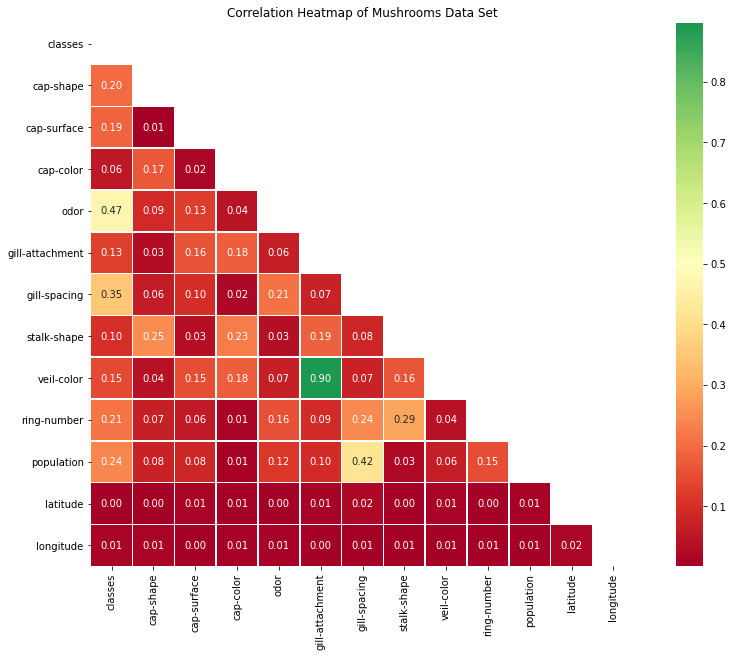

In [13]:
corr = data.corr().abs()
mask = np.triu(corr)
plt.figure(figsize = (15,10))
sns.heatmap(corr, mask=mask, cmap='RdYlGn', center=0.5, annot = True, fmt = '.2f',square=True, linewidths=.5).set_title('Correlation Heatmap of Mushrooms Data Set')
plt.show()

Pivot table that showing the features that are correlated with the target classes with relation to cross sections.


In [14]:
data_pivot_manipulated = data.copy()
odor = pd.qcut(data_pivot_manipulated['odor'], 4, duplicates='drop')
pivot_table = pd.pivot_table(data_pivot_manipulated, values = 'classes', index = [odor], columns = 'gill-spacing', aggfunc=lambda x: x.mode().iat[0])
print(pivot_table)

gill-spacing      -1   0
odor                    
(-14.571, -0.53]   0   0
(-0.53, 2.66]      0   0
(2.66, 5.79]       1   0
(5.79, 41.66]      1   0


### Analysis of each feature
#### I will take features one by one and see how it relates to the target class.

Related to Cap Shape:
* There are a lot of (0) - Bell shaped mushrooms that are edible than mushrooms that are poisonous. 
* From our data it's seems that the (5) - Sunken shaped mushrooms in our data are edible.
* We can there are a lot of poisonous mushrooms (4) - Knobbed shaped mushroom, so I suggest to don't eat it.

Related to Cap Surface:
* There are a lot of (0) Fibrous surface mushrooms that seems to be safe. 
* The (2) and (3) - Smooth and Scaly surface are more poisonous than the edible ones.

Related to Cap Color:
* The (9) and (7) - Yellow and Red cap colors are the most dangours among all colors according to our data.
* The (8) look like the most safer to eat.
* There are mushrooms with color (0) and (3) -  brown and gray cap color, are more safer them the others.



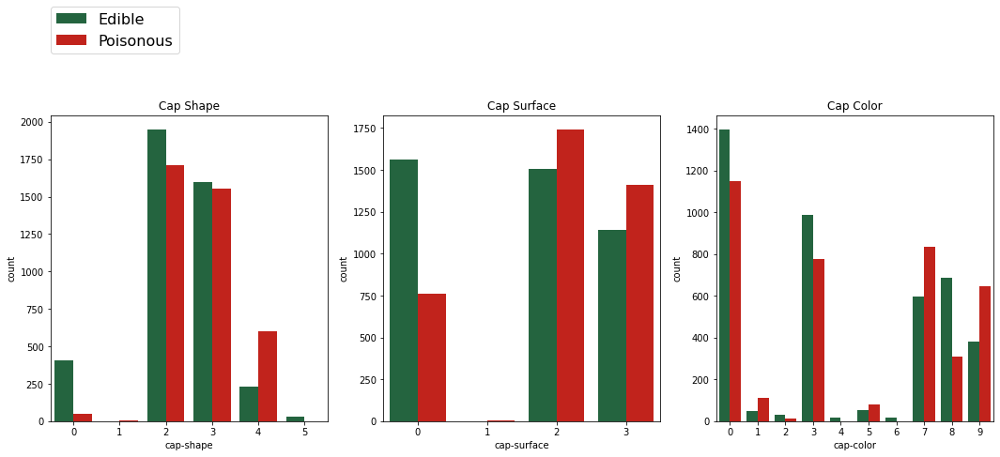

In [15]:
plt.figure(figsize=(18, 6))
plt.subplot(131)
sns.countplot(x='cap-shape', data=data, hue='classes', palette=["#196F3D","#DC0A00"])
plt.title('Cap Shape')
plt.legend(loc=(0, 1.2), labels=['Edible', 'Poisonous'], prop={'size': 16},title_fontsize='21') 

plt.subplot(132)
ax = sns.countplot(x='cap-surface', data=data, hue='classes', palette=["#196F3D","#DC0A00"])
plt.title('Cap Surface')
ax.get_legend().remove()

plt.subplot(133)
ax = sns.countplot(x='cap-color', data=data, hue='classes', palette=["#196F3D","#DC0A00"])
plt.title('Cap Color')
ax.get_legend().remove()
plt.show()

Related to Gill Attachment:
* It's look like (0) Attached is more safer than (2) Free but I think we don't have enough data to prove that.

Related to Gill Spacing:
* It's no safe if you eat mushroom with (-1) - Close Gill Spacing
* Mushrom that have (0) - Crowded Gill Spacing is safer to eat 


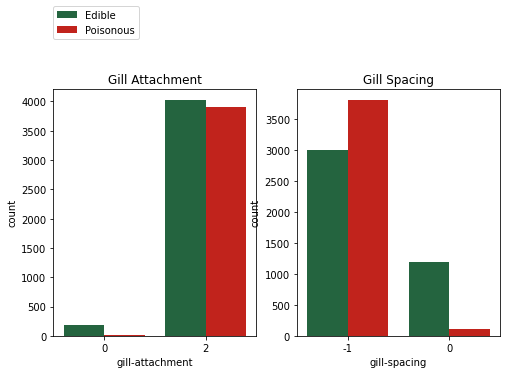

In [16]:
plt.figure(figsize=(8, 10))

plt.subplot(221)
sns.countplot(data=data, x='gill-attachment', hue='classes', palette=["#196F3D","#DC0A00"])
plt.title('Gill Attachment')
plt.legend(loc=(0, 1.2), labels=['Edible', 'Poisonous'], prop={'size': 10},title_fontsize='10') 

plt.subplot(222)
ax = sns.countplot(data=data, x='gill-spacing', hue='classes', palette=["#196F3D","#DC0A00"])
plt.title('Gill Spacing')
ax.get_legend().remove()
plt.show()

Related to Veil Color:
* This feature doesn't tell us much, since fewer records to build a verdit based on it.

Related to Stalk Shape:
* If you see mushroom with (1) tapering probaly is more safer than (0) enlarging.

Related to Ring Number:
* It the mushroom has 2 rings, it's likely to be safe.


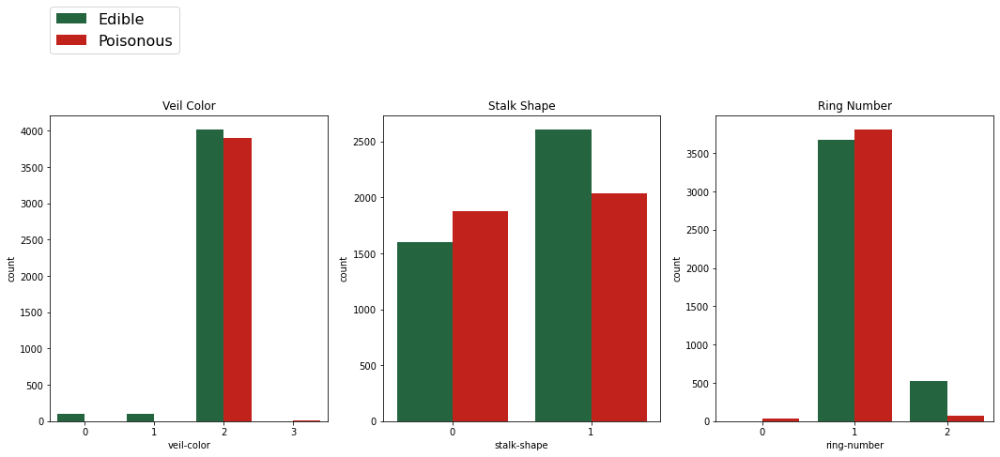

In [17]:
plt.figure(figsize=(18, 6))

plt.subplot(131)
sns.countplot(data=data, x='veil-color', hue='classes', palette=["#196F3D","#DC0A00"])
plt.title('Veil Color')
plt.legend(loc=(0, 1.2), labels=['Edible', 'Poisonous'], prop={'size': 16},title_fontsize='21') 

plt.subplot(132)
ax = sns.countplot(data=data, x='stalk-shape', hue='classes', palette=["#196F3D","#DC0A00"])
plt.title('Stalk Shape')
ax.get_legend().remove()

plt.subplot(133)
ax = sns.countplot(data=data, x='ring-number', hue='classes', palette=["#196F3D","#DC0A00"])
plt.title('Ring Number')
ax.get_legend().remove()

plt.show()

Distribution of odor data 
* From the graphs below seems to be some connection in relation to the amount of odor of each mushroom, it seems that as little odor it's more safer to eat the mushroom

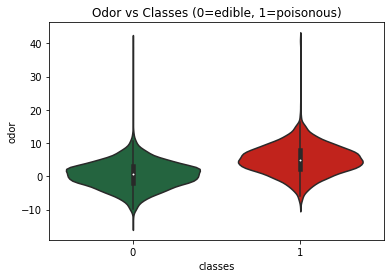

In [18]:
sns.violinplot(data=data, x="classes", y="odor", palette=["#196F3D","#DC0A00"], scale="count").set_title("Odor vs Classes (0=edible, 1=poisonous)")
plt.show()

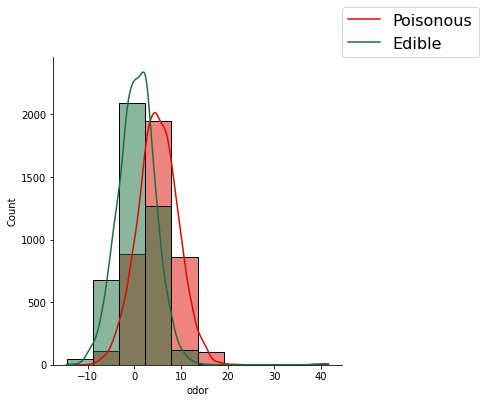

In [19]:
g = sns.displot(data, x="odor", hue='classes', palette=["#196F3D","#DC0A00"], bins=10, kde=True)
g._legend.remove()
plt.legend(loc=(1, 1), labels=['Poisonous', 'Edible'], prop={'size': 16},title_fontsize='21') 
plt.show()

Distribution of population data 
* From the graphs below seems to be some connection in relation to the amount of population of each mushroom, it seems that as higher population it possible can indicate a edible mushroom

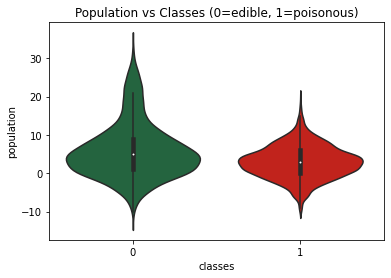

In [20]:
sns.violinplot(data=data, x="classes", y="population", palette=["#196F3D","#DC0A00"], scale="count").set_title("Population vs Classes (0=edible, 1=poisonous)")
plt.show()

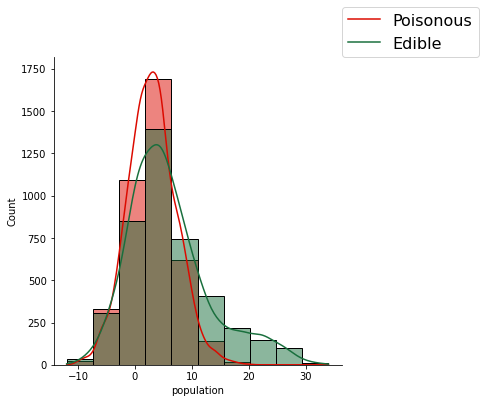

In [21]:
g = sns.displot(data, x="population", hue='classes', palette=["#196F3D","#DC0A00"], bins=10, kde=True)
g._legend.remove()
plt.legend(loc=(1, 1), labels=['Poisonous', 'Edible'], prop={'size': 16},title_fontsize='21') 
plt.show()


Mapping the lon/lat coordinate values, from the plot we can see that the mushrooms located at two specific latitudes.
We can see that in one area there are more mushrooms than in the other area.

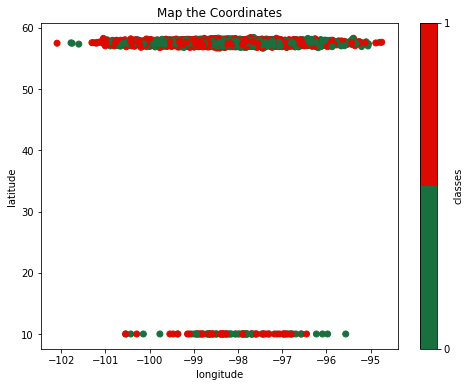

In [22]:
lat, lon = data['latitude'], data['longitude']
plt.figure(figsize=(8, 6))
plt.scatter(x=lon, y=lat, label=None, c=data['classes'],cmap=clr.ListedColormap(['#196F3D', '#DC0A00']), linewidth=1, alpha=1)
plt.xlabel('longitude')
plt.ylabel('latitude')
plt.colorbar(label='classes', ticks=sorted(data.classes.unique()), format='%d')
plt.title("Map the Coordinates")
plt.show()


### Visualization for relevant and interesting features
According to our data set we can see there is more edible mushrooms (4%) than poisonous.


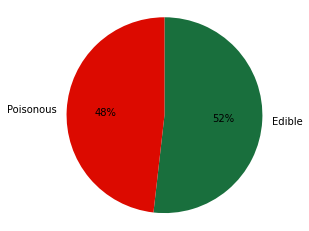

In [23]:
sorted_counts = data['classes'].value_counts()
colors = ["#196F3D", "#DC0A00"]

plt.pie(sorted_counts, labels=['Edible', 'Poisonous'], colors=colors, startangle=90, counterclock=False, autopct='%1.0f%%')
plt.axis('square')
plt.show()

Let's check if there is some certain relationship between the odor strength of each mushroom to the population? from the graph below we can see that for edible mushrooms that grow in high population not necessarily have a stronger odor

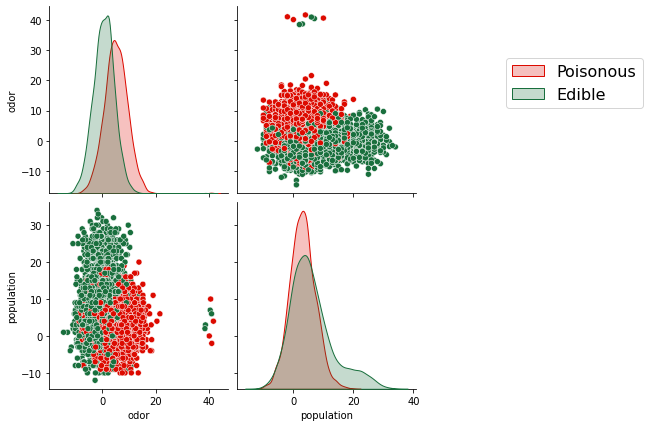

In [24]:
g = sns.pairplot(data[['odor', 'population', 'classes']], hue='classes', palette=["#196F3D","#DC0A00"], height=3)
g._legend.remove()
plt.legend(loc=(1.5, 1.5), labels=['Poisonous', 'Edible'], prop={'size': 16},title_fontsize='21') 
plt.show()


Let's check if the gill-spacing can affect the odor? from the graph below we can see that mushrooms with gill-spacing value of 0 will inevitably be an edible mushrooms and its odor intensity will be low.

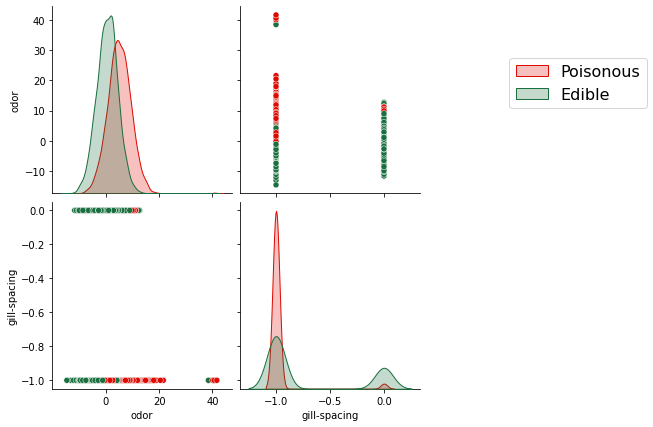

In [25]:
g = sns.pairplot(data[['odor', 'gill-spacing', 'classes']], hue='classes', palette=["#196F3D","#DC0A00"], height=3)
g._legend.remove()
plt.legend(loc=(1.5, 1.5), labels=['Poisonous', 'Edible'], prop={'size': 16},title_fontsize='21') 
plt.show()

## Classification Model


In [26]:
def gaussian_naive_bayes(df, target, score, report):
    x_train, x_test, y_train, y_test = train_test_split(df, target, test_size=0.2, random_state=1)
    model = GaussianNB()                       
    model.fit(x_train, y_train.values.ravel()) 
    y_model = model.predict(x_test)           

    if(score):
        print("accuracy score: ", metrics.accuracy_score(y_test, y_model))

    if(report):    
        print(metrics.classification_report(y_test, y_model))

    return model

### Gaussian Naïve Bayes
First we need to find the 2 features that will yield the best results based the pairplot and correlation.

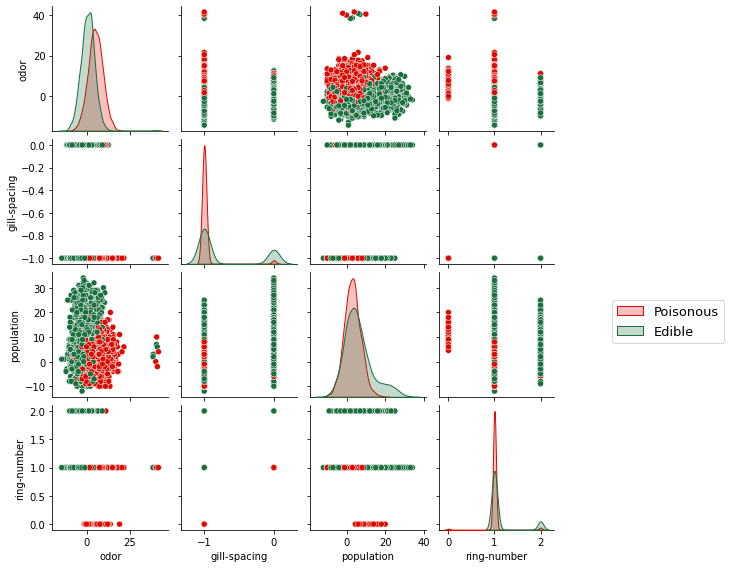

In [27]:
g = sns.pairplot(data=data[['odor','gill-spacing','population','ring-number','classes']], hue='classes', palette=["#196F3D","#DC0A00"], height=2)
g._legend.remove()
plt.legend(loc=(1.5, 1.5), labels=['Poisonous', 'Edible'], prop={'size': 13}, title_fontsize='13')
plt.show() 

From the upper plot we can see that there are three pairs of candidates features that their graphs with better separation of species. To check which one of the three pair of features are most accurate, we will check who have the better accuracy based the models trained on:



In [28]:
X = data[['odor', 'gill-spacing']]
y = data['classes']
print("accuracy of 'odor' and 'gill-spacing'")
clf = gaussian_naive_bayes(X, y , 1, 0)

accuracy of 'odor' and 'gill-spacing'
accuracy score:  0.6707692307692308


In [29]:
X = data[['odor', 'population']]
y = data['classes']
print("accuracy of 'odor' and 'population'")
clf = gaussian_naive_bayes(X, y , 1, 0)

accuracy of 'odor' and 'population'
accuracy score:  0.7224615384615385


In [30]:
X = data[['odor', 'ring-number']]
y = data['classes']
print("accuracy of 'odor' and 'ring-number'")
clf = gaussian_naive_bayes(X, y , 1, 0)

accuracy of 'odor' and 'ring-number'
accuracy score:  0.6744615384615384


In [31]:
def gnb_contour_with_incorrect_scatter(df, target):
    df.dropna()

    clf = gaussian_naive_bayes(df, target, 0, 1)

    y_pred_full = clf.predict(df)
    y_pred_series = pd.Series(y_pred_full)
    
    target_series = pd.Series(target)

    incorrect_data = []
    for i in range(len(y_pred_series)):
        if y_pred_series[i] != target_series[i]:
            incorrect_data.append(i)

    new_data = pd.DataFrame(columns=['odor', 'population', 'classes'])

    i = 0
    for f in incorrect_data:
        new_data.loc[i] = ([df.loc[f]['odor']] + [df.loc[f]['population']] + [target.loc[f]])
        i += 1

    new_data["classes"] = new_data["classes"].astype(float).astype(int)

    tmp = new_data.sample(2000)

    x_min, x_max = df.loc[:, 'odor'].min() - 1, df.loc[:, 'odor'].max() + 1
    y_min, y_max = df.loc[:, 'population'].min() - 1, df.loc[:, 'population'].max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.2), np.arange(y_min, y_max, 0.2))

    z = clf.predict_proba(np.c_[xx.ravel(), yy.ravel()])
    z = np.argmax(z, axis=1)
    z = z.reshape(xx.shape)

    plt.contourf(xx, yy, z, cmap='Dark2', alpha=0.5)
    plt.colorbar()
    plt.clim(0, len(clf.classes_)+3)
    fig = plt.gcf()
    fig.set_size_inches(12, 8)
    plt.xlabel('odor')
    plt.ylabel('population')

    sns.scatterplot(data=tmp, hue='classes', palette='Dark2', x='odor', y='population')
    fig = plt.gcf()
    fig.set_size_inches(12, 8)
    plt.show()

              precision    recall  f1-score   support

           0       0.74      0.69      0.72       820
           1       0.71      0.75      0.73       805

    accuracy                           0.72      1625
   macro avg       0.72      0.72      0.72      1625
weighted avg       0.72      0.72      0.72      1625



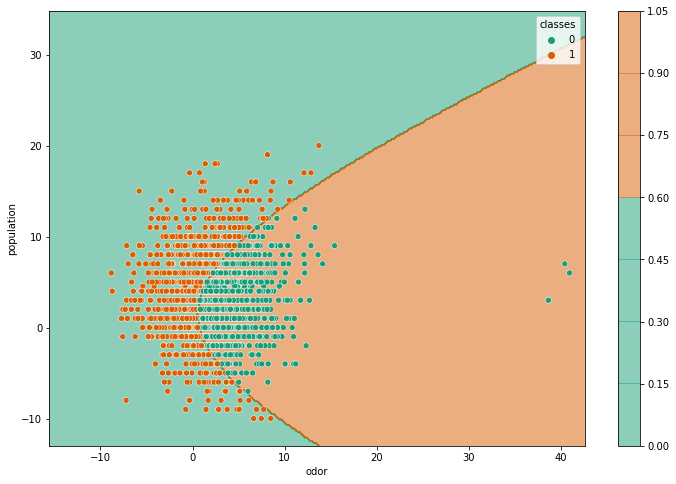

In [32]:
X = data[['odor', 'population']] 
y = data['classes']

gnb_contour_with_incorrect_scatter(X, y)

### Decision Tree
a. Show a baseline decision tree classification report for your dataset. A baseline
classification is one where all features were used, all rows containing NA values were
dropped.


Feature: cap-shape, Score: 0.07587
Feature: cap-surface, Score: 0.20234
Feature: cap-color, Score: 0.09373
Feature: odor, Score: 0.15221
Feature: gill-attachment, Score: 0.00489
Feature: gill-spacing, Score: 0.12052
Feature: stalk-shape, Score: 0.22870
Feature: veil-color, Score: 0.01184
Feature: ring-number, Score: 0.05879
Feature: population, Score: 0.05963
Feature: latitude, Score: 0.05048
Feature: longitude, Score: 0.04707
12 []


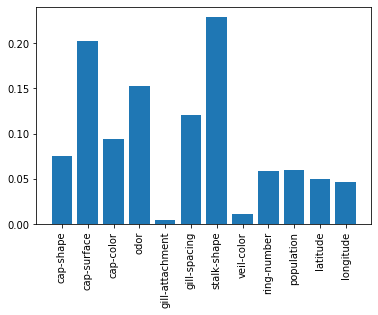

In [33]:
data_copy.dropna(inplace=True)
y = data_copy['classes']
X = data_copy.drop('classes', axis=1)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2,random_state=1)  
clf = DecisionTreeClassifier()
clf.fit(X_train,y_train)
y_pred = clf.predict(X_test)

result = permutation_importance(clf, X, y, n_repeats=10,random_state=0)
importance = zip(X.columns,result['importances_mean'])

for i,v in importance:
    print('Feature: %s, Score: %.5f' % (i,v))

print(len(X.columns),[x[1] for x in importance])
plt.bar(range(len(X.columns)), result['importances_mean'])
plt.xticks(ticks=range(len(X.columns)),labels=X.columns, rotation=90)
plt.show()

In [34]:
dot_data=StringIO()
export_graphviz(clf,out_file=dot_data,filled=True,rounded=True,feature_names=X.columns,class_names=''.join(str(e) for e in clf.classes_))

graph=pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('tree_baseline.png')
Image(graph.create_png())

In [35]:
print(metrics.classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.87      0.87      0.87       828
           1       0.86      0.86      0.86       762

    accuracy                           0.87      1590
   macro avg       0.87      0.87      0.87      1590
weighted avg       0.87      0.87      0.87      1590



b. Create a decision tree classifier based on your manipulated data set, selecting the most
relevant features.

In [36]:
X_2d = data[["stalk-shape","cap-surface"]]
y_2d = data['classes']
X_train, X_test, y_train, y_test = train_test_split(X_2d, y_2d, test_size=0.2,random_state=1) 
clf = DecisionTreeClassifier()
clf.fit(X_train,y_train)
y_pred = clf.predict(X_test)

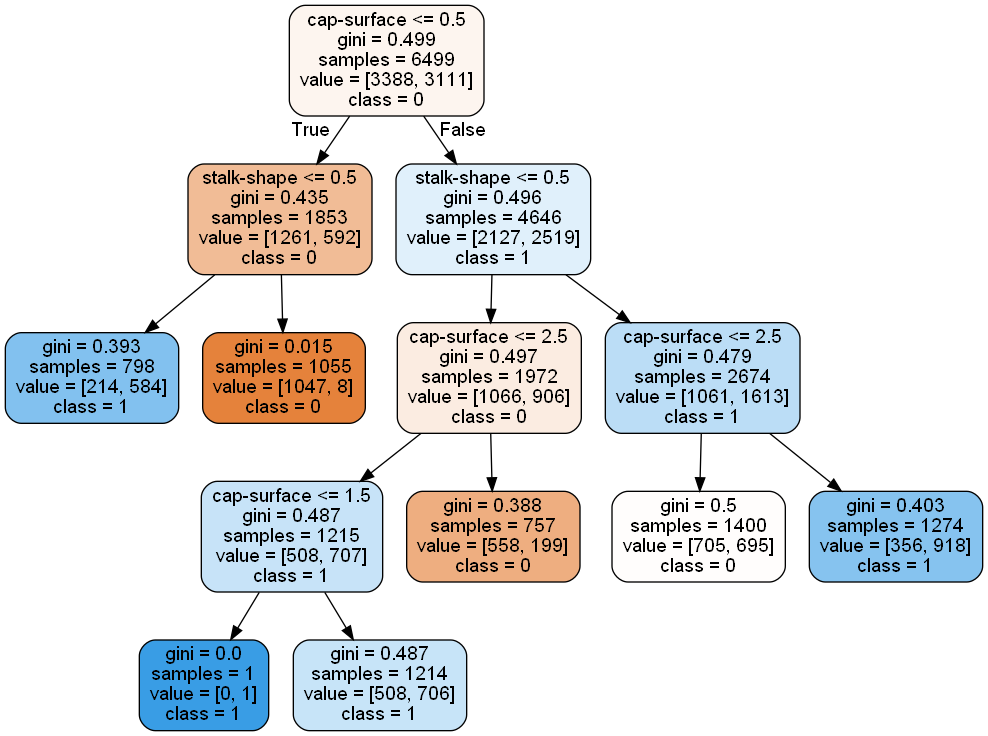

In [37]:
dot_data=StringIO()
export_graphviz(clf,out_file=dot_data,filled=True,rounded=True,feature_names=X_2d.columns,class_names=''.join(str(e) for e in clf.classes_))

graph=pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('tree_manipulated.png')
Image(graph.create_png())

In [38]:
print(metrics.classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.70      0.69      0.70       820
           1       0.69      0.70      0.70       805

    accuracy                           0.70      1625
   macro avg       0.70      0.70      0.70      1625
weighted avg       0.70      0.70      0.70      1625



I tried to get a better result by limiting the max depth and change the citerion, but unfortunately I got the same results.
 

In [39]:
X_2d = data[["stalk-shape","cap-surface"]]
y_2d = data['classes']
X_train, X_test, y_train, y_test = train_test_split(X_2d, y_2d, test_size=0.2,random_state=1) 
clf = DecisionTreeClassifier(max_depth=3, criterion='entropy')
clf.fit(X_train,y_train)
y_pred = clf.predict(X_test)

In [40]:
print(metrics.classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.70      0.69      0.70       820
           1       0.69      0.70      0.70       805

    accuracy                           0.70      1625
   macro avg       0.70      0.70      0.70      1625
weighted avg       0.70      0.70      0.70      1625



No, I wasn't able to improve performance. When I used baseline decision tree classification the accuracy was 0.87 and When I used decision tree classifier based on my manipulated data set the accuracy droped down to 0.70.

## Summary
### Results Overview
* The most correlated features with the target 'classes' are: 'odor', 'gill-spacing'
* The classification model of the Decision Tree were better results from the classification model of the Gaussian Naïve Bayes.
* The classification model of the Decision Tree did not yeild better results when we tried to limit the tree's depth.
### Issues
I had issues like think how to yield better results when I had to classify the data set.
### Insights from the Analysis
I deduced from the graphs interesting data such which of the given features can classify mushroom whether it's edible or poisionous, and some interesting relationships between them.
### Classification Performance Measure
The classification model of the Gaussian Naïve Bayes give average accuracy score, when we selected the two best features it's gave accuracy score of 0.72.
The classification model of the Decision Tree with the manipulated data set did not gave better accuracy score from the baseline decision tree classification 0.87, so we were not able to improve performance so far but, each of the scores got 0.70, this no perfect accuracy but relative to a uniform distribution of 2 values would give about 0.5 to each of them if we chose randomly. So it's still better than a random choice but probably less good at using all the features.
In conclusion, the classification performance measure best fits for mushrooms data set was the classification model of the Decision Tree that give better accuracy score.